# Examining the influence of Covid-19 pandemic on pedestrian traffic and environment in Melbourne, Australia

## Table of content:
-   #### [Setup environment](#Setup_environment)
-   #### [Imports](#imports)
-   #### [1. Motivation.](#1)
-   #### [2. Basic stats. Let's understand the dataset better](#2)
-   #### [3. Data Analysis.](#3)
-   #### [4. Genre.](#4)
-   #### [5. Visualizations.](#5)
-   #### [6. Discussion. Think critically about your creation](#6)
-   #### [7. Contributions. Who did what?](#7)
-   #### [8. References](#8)
-   #### [9. Appendix](#9)

### Links:
- [Our website](https://link-url-here.org)
- [GitHub with Data](https://link-url-here.org)

<a id='Setup_environment'></a>

# Setup environment

The cell below contains install commands for all the packages used in this project that are not installed in jupyter environment by default. If you wish to re-run the notebook on you computer, you might need to uncommend those.

In [1]:
# !pip install --upgrade pip
# !pip install sodapy
# !pip install geopandas
# !pip install geopy
# !pip install pygeos
# !pip install pandas-profiling
# !pip install ipywidgets
# !pip install imblearn
# !pip install keplergl

<a id='imports'></a>

# Imports

In [2]:
import folium
import geopandas as gpd
import math
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import pandas as pd
import numpy as np
import seaborn as sns
import sklearn
import datetime

from bokeh.io import show, output_notebook
from bokeh.models import CustomJS, DateRangeSlider
from bokeh.io import output_file, show, reset_output
from bokeh.layouts import column, row
from bokeh.models import (BasicTicker, ColorBar, ColumnDataSource,
                          LinearColorMapper, PrintfTickFormatter, HoverTool, Panel, Tabs, VBar, SingleIntervalTicker, LinearAxis, BoxAnnotation)
from bokeh.plotting import figure, output_file, save
from bokeh.transform import transform
from bokeh.models import Span


from datetime import date
from imblearn.under_sampling import RandomUnderSampler
from geopy.geocoders import Nominatim
from keplergl import KeplerGl

from pandas.api.types import CategoricalDtype
from pandas_profiling import ProfileReport

from sklearn.ensemble import RandomForestClassifier
from sklearn.preprocessing import LabelEncoder, OneHotEncoder
from sklearn.model_selection import train_test_split, RandomizedSearchCV
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, make_scorer, confusion_matrix, precision_recall_fscore_support, accuracy_score

from sodapy import Socrata

import warnings
warnings.filterwarnings("ignore")



In [3]:
sns.color_palette("crest", as_cmap=True)

%matplotlib inline
plt.style.use('seaborn-dark')

reset_output() # If you are having issues with visualizing Bokeh plots in the notebook try to uncomment this line
output_notebook() # This is to make sure that bokeh plots in the notebook

Loading BokehJS ...

# 1. Motivation.
<a id='1'></a>

## 1.1. What is your dataset?

In our final project, we aim to examine the impact of Covid-19 pandemic, and its evolution on changes in pedestrian traffic, as well as, environmental conditions such as air quality, ambient temperature and soil temperature in Melbourne, Australia. Research indicates that those topics are interconnected. Polish researcher proved in his computer vision based research, that there has been a significant drop (from 33% up to 78%) in the pedestrian traffic after the outbreak of the pandemic in Cracow, Poland [1]. Theere are also clues that there is an relation between pedestrian traffic and wheather conditions [2][3], which seems intuitive.

We will use three sources of data for our analyzes:
- Covid-19 data - Covid-19 cases data has been obtained from John Hopkins University's GitHub repository [4]. 
- Pedestrian traffic data - sensors locations [5] and readings [6]- from City of Melbourne Open Data
- Microclimate data - sensors locations [7] and readings [8] - from City of Melbourne Open Data

Additionally we used dataset with shapes of suburbs in Melbourne and surrounding which is subset of "Australian Statistical Geography Standard" [13]. 

## 1.2. Why did you choose this/these particular dataset(s)?
We find this topic very interesting because it affects all of us, yet it's still fairly new and not examined completely. As stated above, we are pretty sure about the Covid-19 pandemic's influence on pedestrians, and about the connection between weather (in our case 'microclimate') and pedestrian traffic. However, despite many clues in the research [9] and in the media that Covid-19 has influenced the environment, we are not sure how this effect looks like in the micro scale and if there is any. We also find it relevant as we still rarely see informative visualizations that can make such topics more comprehensible.

## 1.3. What was your goal for the end user's experience?
Our goal was to deliver a comprehensible narrative data story that will answer our question of "what was the influence of Covid-19 pandemic on pedestrian traffic and environment in Melbourne, Australia?". We wanted to achieve this by providing an end user with 'poster-like' website combining several visualizations, incorporating interactivity and facilitating them by relevant annotations. While scrolling down through the website the user will be uncover more detailed information and will ultimately gain informative insight into the topic of interest. 

This notebook, on the other hand, is a step by step guide through our analyses. Apart from the final visuals created for the website, it presents all the steps including data obtaining, preprocessing and challenges we encountered. The courious user will find all the necessary information needed to reproduce our analyzes.

In the macro scale, our research can provide the world with information that can help policy makers develop programmes to promote walking, transport engineers to deal with operational and capacity challenges, and demand modellers to incorporate walking as a mode of transport into regional models to better estimate non-motorised trips.  In addition, our ML model can serve as a starting point to predict pedestrian traffic volumes and decide on travel times based on these results.

Increased nonmotorized mobility will reduce energy consumption, enhance the transportation system, and promote public health by encouraging people to be more active.

# 2. Basic stats. Let's understand the dataset better

<a id='2'></a>


## 2.1. Datasets Load

First, we loaded the datasets described in part 1.1. Pedestrian traffic data and microclimate data are loading through the Open Data API.

In [4]:
# Load Covid-19 data
cases = pd.read_csv('https://raw.githubusercontent.com/CSSEGISandData/COVID-19/master/csse_covid_19_data/csse_covid_19_time_series/time_series_covid19_confirmed_global.csv')

In [5]:
# create API client
client = Socrata("data.melbourne.vic.gov.au", "9Spvz32jNOPdvbtsNNI3ILKBu")

In [6]:
# Read data about Pedestrian Counting System sensors and microclimate sensors
results_pedestrian_sensors = client.get("h57g-5234", limit=2000)
results_climat_sensors = client.get("irqv-hjr4", limit=2000)

In [7]:
# Read pedestrian traffic data from Pedestrian Counting System
results_pedestrain_traffic = client.get("b2ak-trbp", limit=5000000)
results_climate = client.get("u4vh-84j8", limit=30000000)

In [8]:
# covert API response to DataFrame 
df_pedestrian_sensors = pd.DataFrame.from_records(results_pedestrian_sensors)
df_microclimat_sensors = pd.DataFrame.from_records(results_climat_sensors)
df_pedestrian = pd.DataFrame.from_records(results_pedestrain_traffic)
df_microclimate = pd.DataFrame.from_records(results_climate)
df_pedestrian = df_pedestrian.rename(columns = dict(zip(df_pedestrian.columns, df_pedestrian.columns.str.lower())))

In [9]:
# Load Suburbs shapefile 
df_suburb_shapes = pd.read_csv('suburb_shapes.csv', index_col=0)

## 2.2. Basic stats

To compute basic stats and initial EDA we used Pandas Profiling package. Reports for each dataset creted with Pandas Profiler can be found in section 9. Appendix. 

### 2.2.1. Covid-19 data

**Dataset statistics**

- Number of columns: 842
- Number of rows: 284
- Missing cells: 0
- Duplicate rows: 0
- Total size in memory: 1.8 MB

### 2.2.2. Sensors data - Pedestrian Counting System

**Dataset statistics**

- Number of variables: 11
- Number of rows: 78
- Missing cells: 76
- Duplicate rows: 0
- Total size in memory: 6.8 KiB
- Average record size in memory: 89.6 B

### 2.2.3. Sensors data - Microclimate Sensors

**Dataset statistics**

- Number of variables: 10
- Number of rows: 16
- Missing cells: 17
- Duplicate rows: 0
- Total size in memory: 1.4 KiB
- Average record size in memory: 88.0 B

### 2.2.4. Melburne Suburbs 

**Dataset statistics**

- Number of variables: 13
- Number of rows: 264
- Missing cells: 0
- Duplicate rows: 0
- Total size in memory: 28.9 KiB
- Average record size in memory: 112.6 B

### 2.2.5. Pedestrian traffic

**Dataset statistics**

- Number of variables: 10
- Number of rows: 4225563
- Missing cells: 0
- Duplicate rows: 0
- Total size in memory: 322.4 Mib
- Average record size in memory: 80 B

### 2.2.6. Microclimate

**Dataset statistics**

- Number of variables: 8
- Number of rows: 3899552
- Missing cells: 9198
- Duplicate rows: 0
- Total size in memory: 238.0 MiB
- Average record size in memory: 64.0 B

## 2.3. Data preprocessing and EDA

### 2.3.1. Covid-19 data

Raw data for Melbourne only was not available, therefore we we'll have to work on a full world's dataset and filter it.

In [10]:
cases.head(3)

,Province/State,Country/Region,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,...,4/30/22,5/1/22,5/2/22,5/3/22,5/4/22,5/5/22,5/6/22,5/7/22,5/8/22,5/9/22
0,NaN,Afghanistan,33.93911,67.709953,0,0,0,0,0,0,...,178879,178899,178901,178901,178901,178905,178919,178922,178981,179010
1,NaN,Albania,41.15330,20.168300,0,0,0,0,0,0,...,275107,275167,275177,275191,275211,275266,275310,275341,275366,275372
2,NaN,Algeria,28.03390,1.659600,0,0,0,0,0,0,...,265780,265782,265782,265782,265782,265786,265791,265794,265798,265800


In [11]:
cases[cases['Country/Region']=='Australia'].head(3)

,Province/State,Country/Region,Lat,Long,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,...,4/30/22,5/1/22,5/2/22,5/3/22,5/4/22,5/5/22,5/6/22,5/7/22,5/8/22,5/9/22
9,Australian Capital Territory,Australia,-35.4735,149.0124,0,0,0,0,0,0,...,104941,105739,106705,107769,108830,109879,110846,111599,112407,113368
10,New South Wales,Australia,-33.8688,151.2093,0,0,0,0,3,4,...,2287281,2294900,2304435,2316269,2334360,2345156,2356642,2365484,2373235,2383412
11,Northern Territory,Australia,-12.4634,130.8456,0,0,0,0,0,0,...,63289,63568,64151,64540,64983,64983,65659,65881,66083,66427


Fortunately, the Australian data it divided into regions, so we'll filter the data to analyze only data for the region in which Melbourne is - Victoria. As, we saw in the head of the raw data - there is a column for each date, so that all the countries can fit in a CSV file. Thus, we have to transform our Dataframe so that we have a column with dates and a column for number of active cases.

In [12]:
# Prepare Covid-19 data - we filter the data to analyze the Victoria region of Australia only
australia = cases[cases['Country/Region']=='Australia']
victoria = australia[australia['Province/State']=='Victoria']

c_names = []
for x in victoria.columns[4:]:
    c_names.append(x)
    
long_au = pd.melt(victoria, id_vars =['Country/Region'],
                value_vars = c_names,
                value_name = 'Cases',
                var_name = 'Day')
# date
long_au.Day = (pd.to_datetime(long_au.Day, format='%m/%d/%y', errors='ignore'))
long_au.head(3)

,Country/Region,Day,Cases
0,Australia,2020-01-22,0
1,Australia,2020-01-23,0
2,Australia,2020-01-24,0


Lets make sure our Covid-19 data does not have any missing values.

In [13]:
long_au.isnull().sum()

Country/Region    0
Day               0
Cases             0
dtype: int64

In [14]:
long_au.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 839 entries, 0 to 838
Data columns (total 3 columns):
 #   Column          Non-Null Count  Dtype         
---  ------          --------------  -----         
 0   Country/Region  839 non-null    object        
 1   Day             839 non-null    datetime64[ns]
 2   Cases           839 non-null    int64         
dtypes: datetime64[ns](1), int64(1), object(1)
memory usage: 19.8+ KB


We collected the dates of 6 lockdowns that took place in Melbourne [9], which we'll need for the analyses.

In [15]:
#Dates of 6 lockdowns in Melbourne, Australia
ld = [['3/30/20','5/12/20'], ['7/8/20','10/27/20'], ['2/12/21','2/17/21'], ['5/27/21','6/10/21'], ['7/15/21','7/27/21'], ['8/5/21','10/21/21']]
ld = [pd.to_datetime(x, format='%m/%d/%y', errors='ignore') for x in ld]

In [16]:
for i, ld_dates in enumerate(ld, 1):
    ld_dates = ld_dates.strftime('%Y-%m-%d')
    print(f'Lockdown {i}: start date: {ld_dates[0]} end date {ld_dates[1]}')

Lockdown 1: start date: 2020-03-30 end date 2020-05-12
Lockdown 2: start date: 2020-07-08 end date 2020-10-27
Lockdown 3: start date: 2021-02-12 end date 2021-02-17
Lockdown 4: start date: 2021-05-27 end date 2021-06-10
Lockdown 5: start date: 2021-07-15 end date 2021-07-27
Lockdown 6: start date: 2021-08-05 end date 2021-10-21


### 2.3.2. Sensors and pedestrians' traffic data

**Datatype cast**

The first step after loading the data was to cast data types of values in columns because all data loaded by API by default were strings

In [17]:
# Cast datatypes for pedestriants traffic data
df_pedestrian = df_pedestrian.astype({'id' : 'int64',
 'date_time': 'datetime64',
 'year': 'int64',
 'mdate': 'int64',
 'time': 'int64',
 'sensor_id': 'int64',
 'hourly_counts': 'int64'})
df_pedestrian['time'] = df_pedestrian['date_time'].dt.time
# df_pedestrian = df_pedestrian.rename(columns = dict(zip(df_pedestrian.columns, df_pedestrian.columns.str.lower())))

# df_pedestrian['Time'] = df_pedestrian['date_time'].dt.time

In [18]:
# Cast datatypes for pedestrians counting sensors
df_pedestrian_sensors = df_pedestrian_sensors.astype({'sensor_id': 'int64',
 'installation_date': 'datetime64',
 'latitude': 'float64',
 'longitude': 'float64'})

In [19]:
# Cast datatypes for microclimate sensors
df_microclimat_sensors = df_microclimat_sensors.astype({'site_id': 'int64',
 'last_data': 'datetime64',
 'start_reading': 'datetime64',
 'longitude': 'float64',
 'latitude': 'float64',
 'end_reading': 'datetime64'})

In [20]:
# Cast datatypes for microclimate data
df_microclimate = df_microclimate.astype({'id': 'int64',
'site_id': 'int64',
'value': 'float64'})

**Missing sensors**

Based on basic statistics of pedestrian traffic and sensors data from the Pedestrian Counting System we have a difference in the number of unique sensors (unique sensor ID) in both datasets. In the dataset with pedestrian counts, we have some sensors_id that are not occurring in the sensor locations dataset. Based on the description of the datasets we know that the dataset with sensors was updated last time in September 2021, while the dataset with pedestrians counts is updated with a 1-month delay. Live data from the pedestrian counting system are presented on a map linked below:
http://www.pedestrian.melbourne.vic.gov.au/?_ga=2.44607906.760678413.1541972518-340051665.1506055261#date=05-05-2022&sensor=574Qub_T&time=9

With the use of that map above and google maps we have estimated the location of missing sensors and manually added them to data frame.

In [21]:
# Unique sensors in pedestrian traffic data
sensors_from_records = df_pedestrian['sensor_id'].unique()

In [22]:
# Unique sensors in pedestrian traffic sensors data
sensors_with_location = df_pedestrian_sensors.sensor_id.unique()

In [23]:
# Diffrence in set of unique sensor id from pedestrian traffic data and pedestrian traffic sensors data
[sensor for sensor in sensors_from_records if sensor not in sensors_with_location]

[84, 85, 86]

In [24]:
# Data for sensor 84
sensor_84 = {'sensor_id':'84', 'sensor_description':'Elizabeth St', 'latitude':-37.818037, 'longitude':144.965060, 'installation_date':df_pedestrian[df_pedestrian['sensor_id'] == 84]['date_time'].min()}

In [25]:
# Data for sensor 85
sensor_85 = {'sensor_id':'85', 'sensor_description':'Macaulay Rd (North)', 'latitude':-37.794460580241875, 'longitude':144.92966740501882, 'installation_date':df_pedestrian[df_pedestrian['sensor_id'] == 85]['date_time'].min()}

In [26]:
# Data for sensor 86
sensor_86 = {'sensor_id':'86', 'sensor_description':'Queensberry St', 'latitude':-37.803030, 'longitude':144.949112, 'installation_date':df_pedestrian[df_pedestrian['sensor_id'] == 86]['date_time'].min()}

In [27]:
# Append new sensors to pedestrian traffic sensors data
df_pedestrian_sensors = df_pedestrian_sensors.append(sensor_84,ignore_index=True)
df_pedestrian_sensors = df_pedestrian_sensors.append(sensor_85,ignore_index=True)
df_pedestrian_sensors = df_pedestrian_sensors.append(sensor_86,ignore_index=True)

In [28]:
df_pedestrian_sensors.tail()

,sensor_id,sensor_description,sensor_name,installation_date,status,direction_1,direction_2,latitude,longitude,location,note
76,6,Flinders Street Station Underpass,FliS_T,2009-03-25,A,North,South,-37.819117,144.965583,"{'latitude': '-37.81911704', 'longitude': '144...",Upgraded on 8/09/21
77,79,Flinders St (South),FliSS_T,2021-09-10,A,West,East,-37.817940,144.966167,"{'latitude': '-37.81794046', 'longitude': '144...",NaN
78,84,Elizabeth St,NaN,2022-01-01,NaN,NaN,NaN,-37.818037,144.965060,NaN,NaN
79,85,Macaulay Rd (North),NaN,2022-01-01,NaN,NaN,NaN,-37.794461,144.929667,NaN,NaN
80,86,Queensberry St,NaN,2022-01-01,NaN,NaN,NaN,-37.803030,144.949112,NaN,NaN


**Convert geo data to Geo Data Frame**

Dataframes which contain geo variables were converted into GeoDataFrames to make it easier to deal with geodata.

In [29]:
# convert DataFrame to GeoDataFrame
gdf_pedestrian_sensors = gpd.GeoDataFrame(df_pedestrian_sensors,
                                        geometry=gpd.points_from_xy(df_pedestrian_sensors.longitude, df_pedestrian_sensors.latitude))

In [30]:
# convert DataFrame to GeoDataFrame
gdf_microclimat_sensors = gpd.GeoDataFrame(df_microclimat_sensors,
                                            geometry=gpd.points_from_xy(df_microclimat_sensors.longitude, df_microclimat_sensors.latitude))

In [31]:
# convert convert string into multipolygon
df_suburb_shapes['geometry'] = gpd.GeoSeries.from_wkt(df_suburb_shapes['geometry'])

In [32]:
# convert DataFrame to GeoDataFrame
gdf_suburb_shapes = gpd.GeoDataFrame(df_suburb_shapes, geometry=df_suburb_shapes.geometry)

**Join sensors data with suburbs data**

To get a better view of how are located sensors in Melbourne, and to aggregate them into groups we joined sensors data with suburbs data. We have done left join suburbs data to sensors data by matching the locations of sensors (points) into shapes of suburbs (multipolygons/polygons) .

In [33]:
# Join pedestrians sensors gdf with suburbs shape gdf
gdf_pedestrian_s_joined=gpd.sjoin(gdf_pedestrian_sensors, gdf_suburb_shapes,how='left',predicate='within')

In [34]:
# Join microclimat sensors gdf with suburbs shape gdf
gdf_microclimat_s_joined=gpd.sjoin(gdf_microclimat_sensors,gdf_suburb_shapes,how='left',predicate='within')

**Sensors in Suburbs**

Joined data we grouped by suburb and we counted the number of sensors in each suburb.

In [35]:
# Count number of sensors per suburb
df_sensors_count_p = pd.DataFrame(gdf_pedestrian_s_joined.SA2_NAME16.value_counts())
df_sensors_count_c = pd.DataFrame(gdf_microclimat_s_joined.SA2_NAME16.value_counts())
df_sensors_count = df_sensors_count_p.join(df_sensors_count_c, how='left', rsuffix='r')
df_sensors_count.columns = ['sensors pedestriants', 'sensors microclimate']
df_sensors_count

,sensors pedestriants,sensors microclimate
Melbourne,54,7.0
Docklands,8,4.0
Carlton,5,5.0
Parkville,4,NaN
Southbank,4,NaN
Kensington (Vic.),2,NaN
North Melbourne,2,NaN
East Melbourne,2,NaN


In a table above we can see that most of sensors from pedestrian counting systems and microclimate are located in Melbourne suburb.

**Sensors location**

Location of sensors we presented on a map. With blue markers, we marked sensors from Pedestrian Counting System, and with green markers microclimate sensors. The black lines indicate the borders of suburbs. 
Location of sensors we presented on a map. With blue markers, we marked sensors from Pedestrian Counting System, and with green markers microclimate sensors. The black lines indicate the borders of suburbs.

In [36]:
# create a folium map object
m = folium.Map(location=[-37.803958, 144.955882], zoom_start=14.25)

# add markers with pedestriants sensors
for i, values in gdf_pedestrian_s_joined[['latitude', 'longitude', 'sensor_description']].iterrows():
    folium.Marker(
    location=[values['latitude'], values['longitude']],
    popup=values['sensor_description'],
    icon=folium.Icon(icon='glyphicon-user', prefix='glyphicon')
).add_to(m)

# add markers with microclimate sensors
for i, values in gdf_microclimat_s_joined[['latitude', 'longitude', 'description']].iterrows():
    folium.Marker(
    location=[values['latitude'], values['longitude']],
    popup=values['description'],
    icon=folium.Icon(color='green', icon='glyphicon-leaf', prefix='glyphicon')
).add_to(m)

    
# draw suburbs borders    
for _, r in gdf_suburb_shapes.iterrows():
    # Without simplifying the representation of each borough,
    # the map might not be displayed
    sim_geo = gpd.GeoSeries(r['geometry'])
    geo_j = sim_geo.to_json()
    geo_j = folium.GeoJson(data=geo_j,
                           style_function=lambda x: {
        'color': 'black',
        'weight': 2.5,
        'fillOpacity': 0
    })
    folium.Popup(r['SA2_NAME16']).add_to(geo_j)
    geo_j.add_to(m)
    
m  

Map shows distribution of sensors in the city. Most of the sensors are located in central part of city of Melbourne, especially in suburb Melbourne as it was shown in previous step.

**Select period**

We want to analyze what pedestrian traffic looks like before, during, and after COVID-19, but also what is the impact of microclimate on this traffic. Due to the period of microclimate data, we decided to analyze only data beginning from 2019. From pedestrians' traffic data we selected data from the assumed period. They are covering 3 periods we are interested in before, during, and after the pandemic.

In [37]:
# select records creaded from 2019
df_pedestrians_2019 = df_pedestrian[df_pedestrian.date_time.dt.year >= 2019]

**Sensors records by year**

For the selected pedestrians' traffic data subset, we explored how looks the yearly number of records for each sensor.

In [38]:
# create yearly counts of records for each sensors
df_year_sensor_cnt = df_pedestrians_2019[['sensor_id', 'id']].groupby(by=['sensor_id',pd.DatetimeIndex(df_pedestrians_2019['date_time']).year]).count()
df_year_sensor_cnt = df_year_sensor_cnt.pivot_table(index='date_time', columns='sensor_id', values=['id'])
df_year_sensor_cnt.columns = [index[1] for index in df_year_sensor_cnt.columns.to_flat_index()]

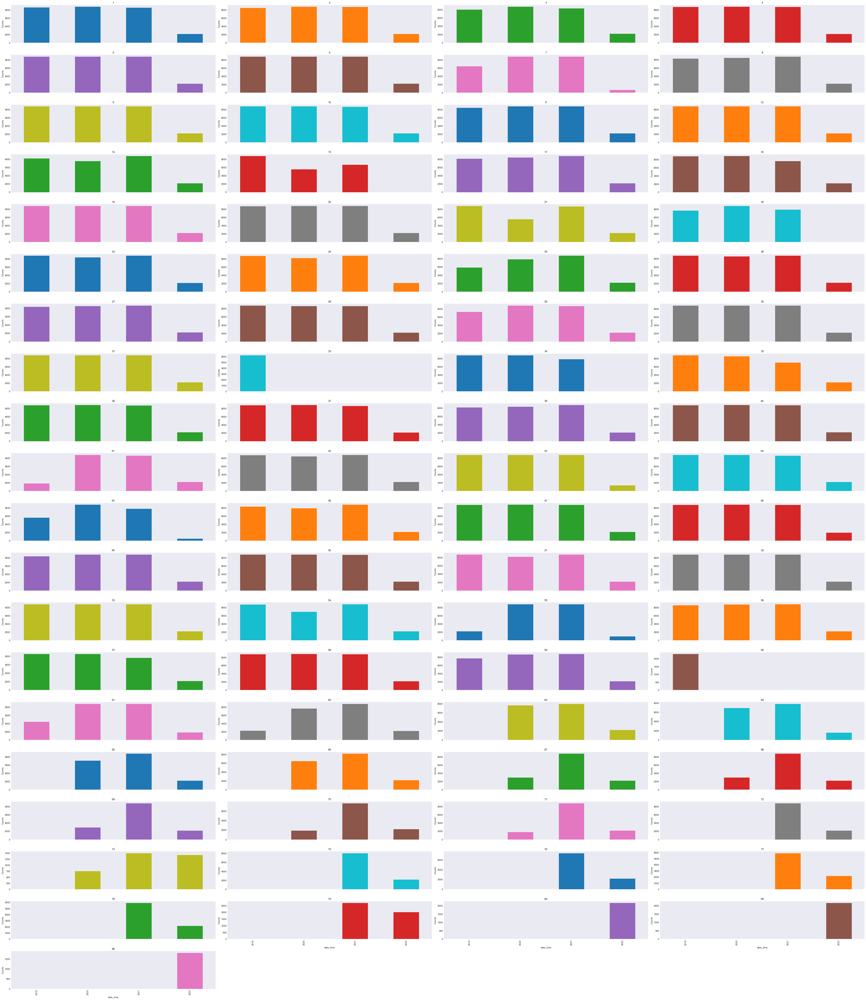

In [39]:
# plot counts
df_year_sensor_cnt.plot(kind='bar', subplots=True, figsize=(50, 60), layout=(21, 4), legend=False, ylabel='Counts')
plt.xticks(fontsize=12)
plt.tight_layout()
plt.show()

As we observe on the plots not all sensors have records for the entire analyzed period (2019-2022). Reson of that is fact that some of the sensors have been set up during this period as well as some of them have been turned off. To have a full-time comparison we decided to use in the further analysis only records from sensors for which we have data for each year of the period.

In [40]:
# drop sensors which do not have data for each year in selected period
df_tmp_nona = df_year_sensor_cnt.dropna(axis=1)

In [41]:
# list of selected sensors
selected_sensors = list(df_tmp_nona.columns)

In [42]:
# select only records from selected sensors
df_pedestrians_final = df_pedestrians_2019[df_pedestrians_2019.sensor_id.isin(selected_sensors)]

### 2.3.3. Microclimate data

**Create plot labels for microclimate data**

On purpose of further visualisation we created dictionary with names of microclimate factors and their units.

In [43]:
# create a labels for microclimate units
air_names = {"TPH.RH-EPA-1h":"humidity","PM2.5-EPA-1h-NOPK":"PM2.5", 
             "PM10-EPA-1h-NOPK":"PM10", "TPH.TEMP-EPA-1h":"temperature", 
             "WS":"wind_speed"
             }
y_axis_labels = {"PM2.5": "PM2.5(ug/m^3)",
                 "PM10": "PM10(ug/m^3)",
                 "humidity": "Humidity(%)",
                 "temperature": "Temperature(°C)",
                 "wind_speed": "Wind speed(km/h)"
                }

**Remove Nan values from microclimate data**

In [44]:
# remove missing cells from microclimate data
df_microclimate = df_microclimate.dropna()

## 2.4 Data preview

In this section we will preview all dataset after data preprocessing and EDA part.

### Covid-19 data|

In [45]:
long_au.head()

,Country/Region,Day,Cases
0,Australia,2020-01-22,0
1,Australia,2020-01-23,0
2,Australia,2020-01-24,0
3,Australia,2020-01-25,0
4,Australia,2020-01-26,1


### Sensors - Microclimate

In [46]:
gdf_microclimat_s_joined.head()

,site_id,gateway_hub_id,description,last_data,site_status,start_reading,longitude,latitude,location,end_reading,...,SA2_NAME16,SA3_CODE16,SA3_NAME16,SA4_CODE16,SA4_NAME16,GCC_CODE16,GCC_NAME16,STE_CODE16,STE_NAME16,AREASQKM16
0,1007,arc1113,Siddeley Street between Spencer Street and Wur...,2022-05-11 07:00:01,C,2021-05-20,144.951835,-37.822460,"{'type': 'Point', 'coordinates': [144.951835, ...",NaT,...,Docklands,20604,Melbourne City,206,Melbourne - Inner,2GMEL,Greater Melbourne,2,Victoria,2.4440
1,1003,arc1047,Pelham Street between Bouverie Street and Leic...,NaT,R,2019-11-15,144.960923,-37.802300,"{'type': 'Point', 'coordinates': [144.960923, ...",2021-06-13,...,Carlton,20604,Melbourne City,206,Melbourne - Inner,2GMEL,Greater Melbourne,2,Victoria,1.8185
2,1014,arc1045,Flinders Street between Swanston Street and El...,2022-05-11 07:00:01,C,2021-09-17,144.967222,-37.817500,"{'type': 'Point', 'coordinates': [144.967222, ...",NaT,...,Melbourne,20604,Melbourne City,206,Melbourne - Inner,2GMEL,Greater Melbourne,2,Victoria,2.3690
3,1008,arc1045,Flinders Street between Swanston Street and El...,NaT,R,2021-06-14,144.967057,-37.817465,"{'type': 'Point', 'coordinates': [144.96705703...",2021-06-20,...,Melbourne,20604,Melbourne City,206,Melbourne - Inner,2GMEL,Greater Melbourne,2,Victoria,2.3690
4,1011,arc1055,"Melbourne Convention Centre Carpark, approxima...",2022-05-11 07:00:01,C,2021-07-07,144.952222,-37.822222,"{'type': 'Point', 'coordinates': [144.952222, ...",NaT,...,Docklands,20604,Melbourne City,206,Melbourne - Inner,2GMEL,Greater Melbourne,2,Victoria,2.4440


### Sensors - Pedestrian Counting System

In [47]:
gdf_pedestrian_s_joined.head()

,sensor_id,sensor_description,sensor_name,installation_date,status,direction_1,direction_2,latitude,longitude,location,...,SA2_NAME16,SA3_CODE16,SA3_NAME16,SA4_CODE16,SA4_NAME16,GCC_CODE16,GCC_NAME16,STE_CODE16,STE_NAME16,AREASQKM16
0,55,Elizabeth St-La Trobe St (East),Eli380_T,2018-07-19,A,North,South,-37.809889,144.961343,"{'latitude': '-37.80988941', 'longitude': '144...",...,Melbourne,20604,Melbourne City,206,Melbourne - Inner,2GMEL,Greater Melbourne,2,Victoria,2.3690
1,45,Little Collins St-Swanston St (East),Swa148_T,2017-06-29,A,North,South,-37.814141,144.966094,"{'latitude': '-37.81414074', 'longitude': '144...",...,Melbourne,20604,Melbourne City,206,Melbourne - Inner,2GMEL,Greater Melbourne,2,Victoria,2.3690
2,61,RMIT Building 14,RMIT14_T,2019-06-28,A,North,South,-37.807675,144.963091,"{'latitude': '-37.80767455', 'longitude': '144...",...,Melbourne,20604,Melbourne City,206,Melbourne - Inner,2GMEL,Greater Melbourne,2,Victoria,2.3690
3,7,Birrarung Marr,Fed_T,2014-12-17,A,East,West,-37.818629,144.971694,"{'latitude': '-37.81862929', 'longitude': '144...",...,East Melbourne,20604,Melbourne City,206,Melbourne - Inner,2GMEL,Greater Melbourne,2,Victoria,2.8998
4,72,Flinders St- ACMI,ACMI_T,2020-11-30,A,East,West,-37.817263,144.968728,"{'latitude': '-37.81726337', 'longitude': '144...",...,East Melbourne,20604,Melbourne City,206,Melbourne - Inner,2GMEL,Greater Melbourne,2,Victoria,2.8998


### Pedestrians traffic data

In [48]:
df_pedestrians_final.head()

,id,date_time,year,month,mdate,day,time,sensor_id,sensor_name,hourly_counts
1,2887629,2019-11-01 17:00:00,2019,November,1,Friday,17:00:00,39,Alfred Place,604
2,2887630,2019-11-01 17:00:00,2019,November,1,Friday,17:00:00,37,Lygon St (East),216
3,2887631,2019-11-01 17:00:00,2019,November,1,Friday,17:00:00,40,Lonsdale St-Spring St (West),627
4,2887632,2019-11-01 17:00:00,2019,November,1,Friday,17:00:00,36,Queen St (West),774
5,2887633,2019-11-01 17:00:00,2019,November,1,Friday,17:00:00,29,St Kilda Rd-Alexandra Gardens,644


### Microclimat - data

In [49]:
df_microclimate.head()

,id,site_id,gateway_hub_id,sensor_id,value,local_time,type,units
0,1,1001,arc1045,0a.EPA-1h,3.9,2019-11-15T09:00:00.000,PM2.5-EPA-1h,ug/m^3
1,2,1001,arc1045,0a.EPA-1h.NOPK,3.9,2019-11-15T09:00:00.000,PM2.5-EPA-1h-NOPK,ug/m^3
2,3,1001,arc1045,0a.EPA-1h.NOPK.EPA-24h,5.5,2019-11-15T09:00:00.000,PM2.5-EPA-1h-NOPK-EPA-24h,ug/m^3
3,4,1001,arc1045,0a.EPA-1h.PKIND,1.0,2019-11-15T09:00:00.000,PM2.5-EPA-1h-PKIND,0/1
4,5,1001,arc1045,0a.EPA-24h,5.5,2019-11-15T09:00:00.000,PM2.5-EPA-24h,ug/m^3


# 3. Data Analysis.
<a id='3'></a>

## 3.1. Covid-19 data analysis

We start by plotting the active covid-19 cases over time in Vicotira region of Australia, to get a grasp of this data, and visualize the magnitude of the pandemic there. Accorind to Australian Bureau of Statistics, the population of this region is slightly higher that 6.6 million people.

The highlighted areas of the plot between the dashed lines depict the lockdown periods.

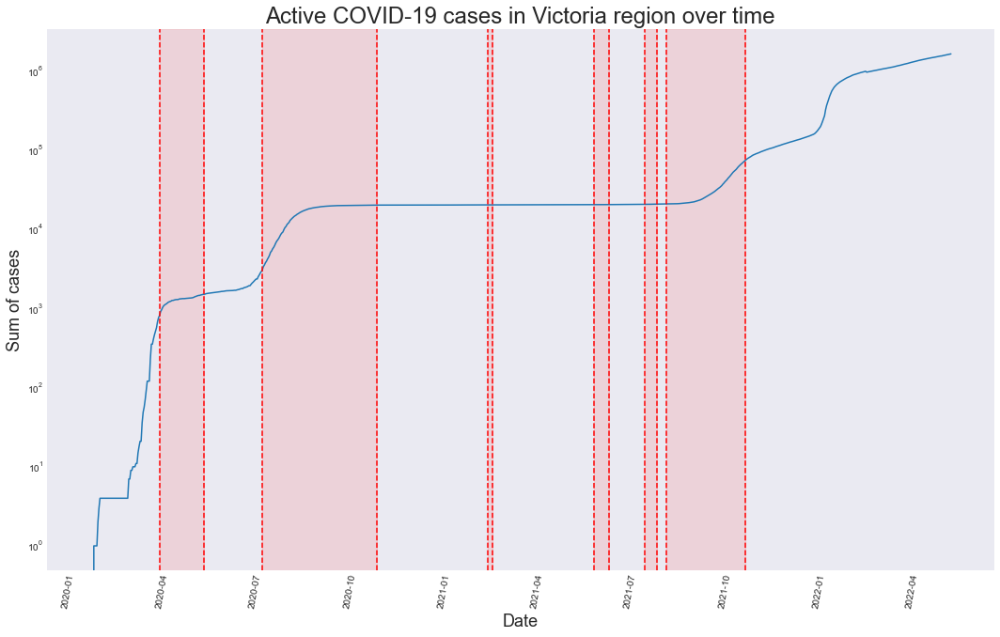

In [50]:
fig = plt.figure(figsize =(14, 8))

# Creating axes instance
ax = fig.add_axes([0, 0, 1, 1])
ax.plot(long_au['Day'],long_au['Cases'])

# Labelling
ax.set_xlabel("Date", fontsize=18)
ax.set_ylabel("Sum of cases", fontsize=18)
ax.set_title("Active COVID-19 cases in Victoria region over time", fontsize=24)

for x in range(len(ld)):
    ax.axvline(ld[x][0], color = "red", linestyle ="--")
    ax.axvline(ld[x][1], color = "red", linestyle ="--")
    plt.axvspan(ld[x][0],ld[x][1], color='red', alpha=0.1)



plt.xticks(rotation=80)
# Display
plt.yscale('log')

plt.show()

In [51]:
#Function that creates an interactive barplot of daily cases for lockdowns
def draw_barplot(ld,no):
    source = ColumnDataSource(ld)
    date = ld['Date']
    # Initializing the plot
    p = figure(x_range=date, plot_height=500, plot_width=950,
           title="Daily cases for Lockdown {}".format(no))
    #Plotting

    p.vbar(x= 'Date',top= 'Cases',source=source,
        width = 0.9,
       fill_alpha = .7,
       fill_color = "#75968f",
       line_alpha = .5,
       line_color="#550b1d"    
          )
    #Signing the axis
    p.xaxis.axis_label="Date"
    p.yaxis.axis_label="New daily cases"
    p.y_range.start = 0
    tooltips = [
    (f"New Covid-19 cases", "@Cases"),
    (f"Date", "@Date")] 

    p.add_tools(HoverTool(tooltips=tooltips ))
    p.toolbar_location = None
    p.xgrid.grid_line_color = None
    p.ygrid.grid_line_color = None
    p.xaxis.major_label_orientation = math.pi/2.5
    p.title.align = "center"
    p.title.text_font_size = "25px"

    return p

In [52]:
#Load the datasets with number of daily cases during lockdowns
ld1 = pd.read_csv('ld1.csv')
ld2 = pd.read_csv('ld2.csv')
ld3 = pd.read_csv('ld3.csv', header= None, names= ['Date','Cases'])
ld4 = pd.read_csv('ld4.csv', header=0,names= ['Date','Cases'])
ld5 = pd.read_csv('ld5.csv', header= None, names= ['Date','Cases'])
ld6 = pd.read_csv('ld6.csv', header= None, names= ['Date','Cases'])

In [53]:
#Creating a figure combining all 6 lockdown datasets
p1 = draw_barplot(ld1, 1)
p2 = draw_barplot(ld2, 2)
p3 = draw_barplot(ld3, 3)
p4 = draw_barplot(ld4, 4)
p5 = draw_barplot(ld5, 5)
p6 = draw_barplot(ld6, 6)

tab1 = Panel(child=p1, title="Lockdown 1")
tab2 = Panel(child=p2, title="Lockdown 2")
tab3 = Panel(child=p3, title="Lockdown 3")
tab4 = Panel(child=p4, title="Lockdown 4")
tab5 = Panel(child=p5, title="Lockdown 5")
tab6 = Panel(child=p6, title="Lockdown 6")

show(Tabs(tabs=[tab1, tab2, tab3, tab4, tab5, tab6]))

## 3.2. Pedestrian traffic data analysis

We want to analyze impact of COVID-19 on pedestrians’ traffic. As it was described in part 2.1.3 we will analzie subset of pedestrians’ traffic data salected based on assumption about the data period 2019-2022 and only from sensors that have a records for each year of given period. 


**Averege hourly pedestrian count over time**

First we wanted to check if we can opserve any impact in general scale. We counted averege hourly count for each month  and then ploted it as bar plot. Also we marked on the plot lockdowns.

In [54]:
# create column with year-month date format
df_pedestrians_final['month_year'] = df_pedestrians_final['date_time'].dt.to_period('M')

In [55]:
# Count avg hourly count for each month
df_counts_per_month = df_pedestrians_final[['month_year','hourly_counts']].groupby(by=['month_year']).mean()

In [56]:
# list of lockdowns in year-month format
ld_months = [['2020-03','2020-05'], ['2020-08','2020-10'], ['2021-02','2021-02'], ['2021-05','2021-06'], ['2021-07','2021-07'], ['2021-08','2021-10']]

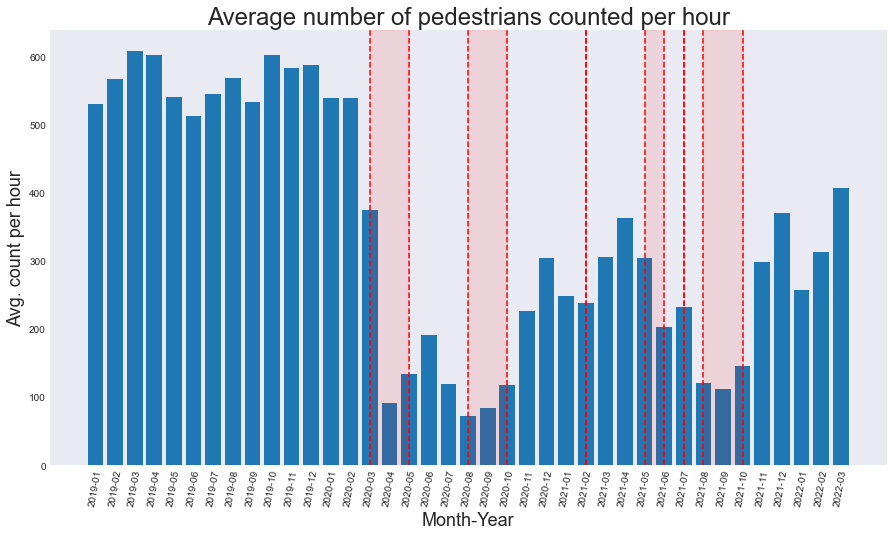

In [57]:
plt.style.use('seaborn-dark')
fig = plt.figure(figsize=(15,8))

# plot avg hourly count for each month
plt.bar(df_counts_per_month.index.astype(str),df_counts_per_month.hourly_counts.values)
plt.xticks(df_counts_per_month.index.astype(str), rotation = 80)
plt.ylabel('Avg. count per hour', fontsize=18)
plt.xlabel('Month-Year', fontsize=18)
plt.title('Average number of pedestrians counted per hour', fontsize=24)

# get ax object
ax = plt.gca()

# mark lockdowns on the plot
for x in range(len(ld_months)):
    ax.axvline(ld_months[x][0], color = "red", linestyle ="--")
    ax.axvline(ld_months[x][1], color = "red", linestyle ="--")
    plt.axvspan(ld_months[x][0],ld_months[x][1], color='red', alpha=0.1)

plt.show()

As we can observe on the plot we have a drop in average number of pedestrians counted per hour beginning from march 2020. This coincides with first lockdown in Melbourne. Overall most of the bigger drops in average number of pedestrians counted per hour are in the time of lockdowns, when the possibilities of the movement were restricted. 

**Spatial patern of monthly average hourly pedestrian count**

To visualise how spatial patern of monthly average hourly pedestrian count looks like over time we created animated plot with Kepler package. High and color of the bars coresponed to the value of average hourly pedestrian count and location of the bar is a location of the sensor which data are visualise.

In [58]:
ped_with_sensor = df_pedestrians_final.copy()
# select the coloumns 
ped_with_sensor = ped_with_sensor[["sensor_id","hourly_counts", "date_time"]]
# change the date to datetime
ped_with_sensor["date_time"] = pd.to_datetime(ped_with_sensor["date_time"])
# aggregate and reindex
ped_with_sensor = ped_with_sensor.groupby(["sensor_id",ped_with_sensor["date_time"].dt.to_period("M").rename("month")]).agg({"hourly_counts":"mean"}).reset_index()
# sort the value by month
ped_with_sensor = ped_with_sensor.sort_values(by='month')
# set index
ped_with_sensor = ped_with_sensor.set_index("sensor_id")
# join with sensor locations
ped_with_sensor = ped_with_sensor.join(df_pedestrian_sensors, on='sensor_id')
ped_with_sensor = ped_with_sensor[["latitude", "longitude", "hourly_counts", "month"]]
ped_with_sensor = ped_with_sensor.reset_index()
# change the format for kepler plot
ped_with_sensor["month"] = ped_with_sensor["month"].astype(str) + "-01 00:00:00"

In [59]:
# load setting
%run kepler_config.py
# show map
map_3D = KeplerGl(data={'data':ped_with_sensor},config=config,height = 500)
map_3D
# Save config to a file
with open('kepler_config.py', 'w') as f:
    f.write('config = {}'.format(map_3D.config))
# save map with provided data and config
map_3D.save_to_html(data={'data': ped_with_sensor}, config=config, file_name='first_map.html')

User Guide: https://docs.kepler.gl/docs/keplergl-jupyter
Map saved to first_map.html!


<Figure size 432x288 with 0 Axes>

Similar as it was on previous visualisation we can observe drop in average hourly pedestrian count in march 2020 when first lockdown began. Morover during whole Covid-19 period we can observe few bars which stay higher then others. Most of those locations are transport hubs sucha as metro stations which explains the higher traffic.

**Daytime pedestrian traffic patterns**

As next want to explore what looks like a daytime pattern in pedestrians’ traffic. For this purpose, we will use a categorical heatmap with days and time on respectively the y-axis and x-axis. W split data into 3 subsets corresponding to periods before, during, and after COVID-19. To subset for the first period (before COVID-19) we selected records from the beginning of data (01-01-2019) to the beginning of the first lockdown (30-03-2020), for COVID-19 period records between the first day of the first lockdown (30-03-2020) and last day of last lockdown (21-10-2021), and for after COVID-19 period all records after the end of last lockdown (21-10-2021).

In [60]:
day_week = [ 'Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']

In [61]:
# split dataframe into befor, during and after covid
df_pedestrians_befor_covid = df_pedestrians_final[df_pedestrians_final.date_time.dt.date < date(2020,3,20)]
df_pedestrians_covid = df_pedestrians_final[(df_pedestrians_final.date_time.dt.date >= date(2020,3,20)) & (df_pedestrians_final.date_time.dt.date <= date(2021,10,21))]
df_pedestrians_after_covid = df_pedestrians_final[df_pedestrians_final.date_time.dt.date > date(2021,10,21)]

In [62]:
# group by day, time
df_grouped_befor_covid = df_pedestrians_befor_covid[['day', 'time', 'hourly_counts']].groupby(by=['day', 'time']).mean().unstack()
df_grouped_covid = df_pedestrians_covid[['day', 'time', 'hourly_counts']].groupby(by=['day', 'time']).mean().unstack()
df_grouped_after_covid = df_pedestrians_after_covid[['day', 'time', 'hourly_counts']].groupby(by=['day', 'time']).mean().unstack()

In [63]:
# format data frames
df_prod_befor_covid = pd.DataFrame(df_grouped_befor_covid.stack(), columns=['hourly_counts']).reset_index()
df_prod_covid = pd.DataFrame(df_grouped_covid.stack(), columns=['hourly_counts']).reset_index()
df_prod_after_covid = pd.DataFrame(df_grouped_after_covid.stack(), columns=['hourly_counts']).reset_index()

In [64]:
# create categorical data based on week days
cat_type = CategoricalDtype(categories=day_week, ordered=True)

In [65]:
# convert type of 'day' column to categorical
df_prod_befor_covid['day'] = df_prod_befor_covid['day'].astype(cat_type)
df_prod_covid['day'] = df_prod_covid['day'].astype(cat_type)
df_prod_after_covid['day'] = df_prod_after_covid['day'].astype(cat_type)

In [66]:
# sor values by day of week
df_prod_befor_covid = df_prod_befor_covid.sort_values(by=['day', 'time'])
df_prod_covid = df_prod_covid.sort_values(by=['day', 'time'])
df_prod_after_covid = df_prod_after_covid.sort_values(by=['day', 'time'])

In [67]:
# convert time to string - make it easier to use it as label for plot
df_prod_befor_covid.time = df_prod_befor_covid.time.astype(str)
df_prod_covid.time = df_prod_covid.time.astype(str)
df_prod_after_covid.time = df_prod_after_covid.time.astype(str)

In [68]:
# create bokeh ColumnDataSource based on DataFrames
source_befor_covid = ColumnDataSource(df_prod_befor_covid)
source_covid = ColumnDataSource(df_prod_covid)
source_after_covid = ColumnDataSource(df_prod_after_covid)

In [69]:
output_notebook()

Loading BokehJS ...

In [70]:
output_file("pedestrian_day_time_pattern.html")

# create color maper for values on heatmap
colors = ["#75968f", "#a5bab7", "#c9d9d3", "#e2e2e2", "#dfccce", "#ddb7b1", "#cc7878", "#933b41", "#550b1d"]
mapper = LinearColorMapper(palette=colors, low=df_prod_befor_covid.hourly_counts.min(), high=df_prod_befor_covid.hourly_counts.max())

# before covid
# hover to display informatrions about values on heatmap
hover1 = HoverTool(
        tooltips=[
            ("day", "@day"),
            ("time", "@time"),
            ("Avg. hourly count", "@hourly_counts"),
        ]
    )

# create categorical heatmap
p1 = figure(width=950, height=500, title="Hourl count",
           y_range=day_week, x_range=list(df_prod_befor_covid.time.unique()),
           toolbar_location=None, tools=[hover1], x_axis_location="above")

p1.rect(y="day", x="time", width=1, height=1, source=source_befor_covid,
       line_color=None, fill_color=transform('hourly_counts', mapper))

color_bar = ColorBar(color_mapper=mapper,
                     ticker=BasicTicker(desired_num_ticks=len(colors)),
                     formatter=PrintfTickFormatter(format="%d"))

p1.add_layout(color_bar, 'right')

p1.axis.axis_line_color = None
p1.axis.major_tick_line_color = None
p1.axis.major_label_text_font_size = "12px"
p1.axis.major_label_standoff = 0
p1.xaxis.major_label_orientation = 1.0

# During covid data
# hover to display informatrions about values on heatmap
hover2 = HoverTool(
        tooltips=[
            ("day", "@day"),
            ("time", "@time"),
            ("Avg. hourly count", "@hourly_counts"),
        ]
    )
p2 = figure(width=950, height=500, title="Hourl count",
           y_range=day_week, x_range=list(df_prod_befor_covid.time.unique()),
           toolbar_location=None, tools=[hover2], x_axis_location="above")

p2.rect(y="day", x="time", width=1, height=1, source=source_covid,
       line_color=None, fill_color=transform('hourly_counts', mapper))

color_bar = ColorBar(color_mapper=mapper,
                     ticker=BasicTicker(desired_num_ticks=len(colors)),
                     formatter=PrintfTickFormatter(format="%d"))

p2.add_layout(color_bar, 'right')

p2.axis.axis_line_color = None
p2.axis.major_tick_line_color = None
p2.axis.major_label_text_font_size = "12px"
p2.axis.major_label_standoff = 0
p2.xaxis.major_label_orientation = 1.0

#After covid
# hover to display informatrions about values on heatmap
hover3 = HoverTool(
        tooltips=[
            ("day", "@day"),
            ("time", "@time"),
            ("Avg. hourly count", "@hourly_counts"),
        ]
    )

# create categorical heatmap
p3 = figure(width=950, height=500, title="Hourl count",
           y_range=day_week, x_range=list(df_prod_befor_covid.time.unique()),
           toolbar_location=None, tools=[hover3], x_axis_location="above")

p3.rect(y="day", x="time", width=1, height=1, source=source_after_covid,
       line_color=None, fill_color=transform('hourly_counts', mapper))

color_bar = ColorBar(color_mapper=mapper,
                     ticker=BasicTicker(desired_num_ticks=len(colors)),
                     formatter=PrintfTickFormatter(format="%d"))

p3.add_layout(color_bar, 'right')

p3.axis.axis_line_color = None
p3.axis.major_tick_line_color = None
p3.axis.major_label_text_font_size = "12px"
p3.axis.major_label_standoff = 0
p3.xaxis.major_label_orientation = 1.0

# add heatmaps to new tabs
tab1 = Panel(child=p1, title="Before COVID-19")
tab2 = Panel(child=p2, title="During COVID-19")
tab3 = Panel(child=p3, title="After COVID-19")

# display plot
show(Tabs(tabs=[tab1, tab2, tab3]))

For all 3 periods, we used the same color scale to visualize the magnitude of the average number of pedestrians counted per hour. The color scale was created based on data before COVID-19. It allows us to not only analyze what the daytime pattern looks like for each period but also compare how magnitude changes in different periods.

Before Covid-19 we can observe the highest pedestrian traffic during rush and office hours during the week (between 7 am and 6 pm)  and between 10 am and 7 pm during weekends. Moreover we can observe higher pedestrian traffic on Friday and Saturday evenings and nights compared to other days at the same time. It is connected with the fact that usually, this is a time when people go out and meet with each other.

For Covid-19 we can observe the decline in pedestrian traffic throughout the week. It is related to lockdowns and the fact that during Covid-19 a lot of people move from office to home office. However, we can still observe higher pedestrian traffic between 12 am and 5 pm than throughout the rest parts of the days.

For a period after Covid-19 we can see that pedestrian traffic increased compared to Covid-19 time. However, a pattern we can observe is slightly different than one we could expect based on daytime patterns from periods before. The pedestrian traffic after Covid-19 is the highest on weekends which is caused by the fact that finally after lockdowns people can go out and meet with each other. On the other hand, not that significant growth of pedestrian traffic during rush and office hours is related to the fact that even though the lockdowns end a lot of people stayed with remote or flexible work. This fact has been the subject of various articles, for instance article  ["Working from home likely to stay long after COVID-19 pandemic is over"](https://www.abc.net.au/news/2021-09-16/work-from-home-productivity-commission-study/100465258), where authors stated that people prefer to work from home cuz it allows them to save time and money on their daily commute.

## 3.3. Microclimate data analysis

We start to explore the microclimate from month to day, finally to each hour. Firstly, we merge all the factors into the pedestrian for the later analysis.

In [71]:
# combine pedestrian with the microclimate
df_pedestrians_final["Date"] = pd.to_datetime(df_pedestrians_final["date_time"])
ped_daily_mean = df_pedestrians_final.groupby([df_pedestrians_final["Date"].dt.to_period("D").rename("Date")]).agg({"hourly_counts":"mean"}).reset_index()

In [72]:
# this function is to filter the microcliamte based on different time scale
def filter_data(col, period):
    data = df_microclimate[df_microclimate["type"] == col]
    data.loc[:, "local_time"] = pd.to_datetime(data["local_time"])
    data_mean = data.groupby(data["local_time"].dt.to_period(period)).agg({"value":"mean"})
    data_mean = data_mean.reset_index()
    return data_mean

In [73]:
ped_daily = ped_daily_mean
# Merge all microclimate with PPM
for name in air_names.keys():
    ped_daily = ped_daily.merge(filter_data(name, "D"), left_on='Date', right_on='local_time', how="right")
    ped_daily = ped_daily.drop(columns=["local_time"])
    ped_daily = ped_daily.rename(columns={"value":air_names[name]})
ped_daily = ped_daily.dropna()

In [74]:
ped_daily["Date"] = ped_daily["Date"].astype(str)
ped_daily["Date"] = pd.to_datetime(ped_daily["Date"])

### 3.3.1. Exploration by month

In [75]:
ped_month = df_pedestrians_final.groupby([df_pedestrians_final["Date"].dt.to_period("M").rename("Month")]).agg({"hourly_counts":"mean"}).reset_index()

# Merge all microclimate with PPM
for name in air_names.keys():
    ped_month = ped_month.merge(filter_data(name, "M"), left_on='Month', right_on='local_time')
    ped_month = ped_month.drop(columns=["local_time"])
    ped_month = ped_month.rename(columns={"value":air_names[name]})

In [76]:
ped_month["Month"] = ped_month["Month"].astype(str)

In [77]:
def draw_monthly_figure(df_, name): 
    y_axis_labels = {"PM2.5": "PM2.5(ug/m^3)",
                     "PM10": "PM10(ug/m^3)",
                     "humidity": "Humidity(%)",
                     "temperature": "Temperature(°C)",
                     "wind_speed": "Wind speed(km/h)"
                     
                    }
    
    src = ColumnDataSource(data=df_)
    
    p = figure(plot_width = 1000,x_range=df_["Month"], plot_height = 500,title = "Relation", background_fill_color="#fafafa")
    # p = figure(plot_width = 1000,x_range=df_["Month"] plot_height = 500,title = "Relation", background_fill_color="#fafafa", x_axis_type='datetime')
    p.xaxis.axis_label = 'Date'
    p.yaxis.axis_label = y_axis_labels[name]

    p.vbar(x="Month", top=name, source=src, width=0.7)
    # Horizontal line
    hline = Span(location=df_[name].mean(), dimension='width', line_color='red', line_width=3, line_dash="dashed")
    
    ld_dt = ld

    #highlight lockdowns
    for x in range(len(ld_dt)):
        index_l = p.x_range.factors.index(ld_dt[x][0].strftime('%Y-%m'))
        index_r = p.x_range.factors.index(ld_dt[x][1].strftime('%Y-%m'))
        delta = (p.x_range.end - p.x_range.start)/len(p.x_range.factors)
        left = 1/2+(delta/2 + index_l)
        right = 1/2+(delta/2 + index_r)
        p.add_layout(BoxAnnotation(left=left, right=right, fill_alpha=0.1, fill_color='red', line_color='red'))
    
    # p.line(x="Month", y=name, source=df_)
    p.title.text = "A measure of " + name + " over time"
    p.title.align = "center"
    p.title.text_font_size = "16px"
    temp = "@"+name
    tooltips = [
        (f'Average {name}: ', "{:.2f}".format(df_[name].mean())),
        # (f'{name}:', temp),
        (f'Date: ', "@Month")
    ]
    p.xaxis.major_label_orientation = 45
    p.renderers.extend([hline])
    p.add_tools(HoverTool(tooltips=tooltips))
    return p

In [78]:
panels = []
for name in air_names.values():
    panels.append(draw_monthly_figure(ped_month, name))

In [79]:
tabs = []
for p, name in zip(panels, air_names.values()):
    tabs.append(Panel(child=p, title=name))

In [80]:
show(Tabs(tabs=tabs))

**Start with monthly average data** 

Microclimates are characterized by cyclical changes, with temperature being the most significant. We compared the monthly data with the average data and found three time periods of climate anomalies. They all significantly exceeded the average data. They are Australian bushfire in 2019-2020, a period of low wind speed from March to May 2021 and an unusually hot January in 2022.We will explore these time periods further in the next sections, scaling up the time scale to daily.

### 3.3.2. Relation between Pedestrians traffic and Microclimate

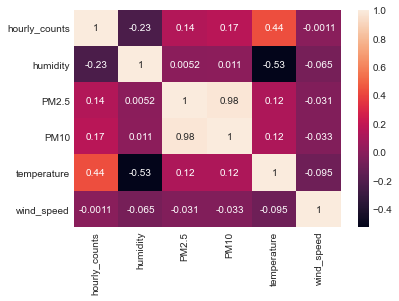

In [81]:
# corelation between climate and PPM
corr = ped_daily.drop(columns=["Date"]).corr()
sns.heatmap(corr, annot = True)
plt.show()


**Relation between each factor** 

Our individual elements were analyzed for correlation and it was easy to find that PM2.5 was highly correlated with up to 98%. And the pedestrian volume has some correlation with the temperature about 40%. The correlation between the rest of the individual elements is relatively small.

##### The cause of the bad air condition - australian bushfires

In [82]:
ped_daily_bushfire = ped_daily[(ped_daily["Date"] >= "2019-12-01") & (ped_daily["Date"] <= "2020-04-01")]

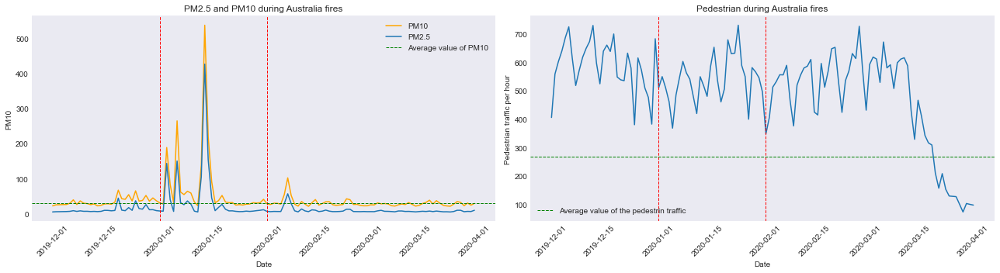

In [83]:
fig, ax = plt.subplots(1,2,figsize=(18,5))

# subplot for PM2.5 and PM10
sns.lineplot(data=ped_daily_bushfire, x="Date", y="PM10", color="orange", label="PM10", ax=ax[0])
sns.lineplot(data=ped_daily_bushfire, x="Date", y="PM2.5", label="PM2.5", ax=ax[0])
ax[0].axvline(x=pd.to_datetime("2020-01-01", format = '%Y-%m-%d'), color='r',  linestyle="--", linewidth=1)
ax[0].axvline(x=pd.to_datetime("2020-02-01", format = '%Y-%m-%d'), color='r',  linestyle="--", linewidth=1)
ax[0].axhline(y=ped_daily["PM10"].mean(), color='green', label='Average value of PM10', linestyle="--", linewidth=1)
ax[0].set_title("PM2.5 and PM10 during Australia fires")
ax[0].tick_params(labelrotation=45, axis='x')
ax[0].legend()

# subplot for pedestrian
sns.lineplot(data=ped_daily_bushfire, x="Date", y="hourly_counts", ax=ax[1])
ax[1].axvline(x=pd.to_datetime("2020-01-01", format = '%Y-%m-%d'), color='r',  linestyle="--", linewidth=1)
ax[1].axvline(x=pd.to_datetime("2020-02-01", format = '%Y-%m-%d'), color='r',  linestyle="--", linewidth=1)
ax[1].axhline(y=ped_daily["hourly_counts"].mean(), color='green', label='Average value of the pedestrin traffic', linestyle="--", linewidth=1)
ax[1].set_title("Pedestrian during Australia fires")
ax[1].set_ylabel('Pedestrian traffic per hour')
ax[1].tick_params(labelrotation=45, axis='x')
ax[1].legend()

fig.tight_layout()


**Bushfire from January to February in 2020**

When we zoom out to January 2020 versus February 2020, it is easy to see that there is a significant increase in PM10 and PM2.5 values relative to normal at this time. However, when comparing with the pedestrian volume during this period, it is found that there is no significant impact on the values during this period. The level of PM does not significantly affect people's travel.

##### Explore low wind speed

In [84]:
def draw_lockdown_in_period(ax, start, end):
    for x in range(len(ld)):
        if ld[x][1] < start or ld[x][0] > end:
            continue
        ax.axvline(ld[x][0], color = "red", linestyle ="--")
        ax.axvline(ld[x][1], color = "red", linestyle ="--")
        ax.axvspan(ld[x][0],ld[x][1], color='red', alpha=0.1)

In [85]:
start_date = "2021-02-1"
end_date = "2021-07-1"
start = datetime.datetime.strptime(start_date, '%Y-%m-%d')
end = datetime.datetime.strptime(end_date, '%Y-%m-%d')

In [86]:
ped_daily_low_wind = ped_daily[(ped_daily["Date"] >= start_date) & (ped_daily["Date"] <= end_date)]

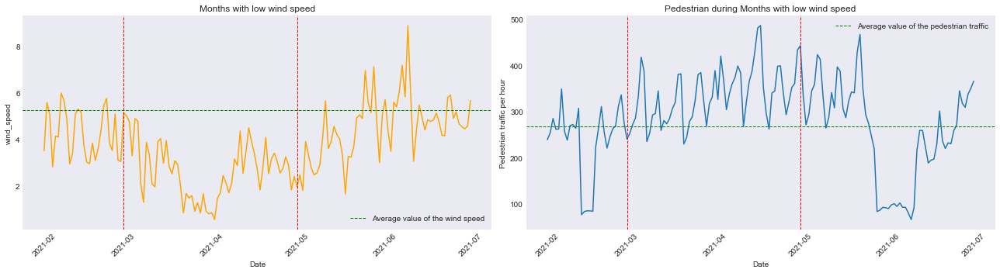

In [87]:
fig, ax = plt.subplots(1,2,figsize=(18,5))

# subplot for wind speed
sns.lineplot(data=ped_daily_low_wind, x="Date", y="wind_speed", color="orange", ax=ax[0])
ax[0].axvline(x=pd.to_datetime("2021-03-01", format = '%Y-%m-%d'), color='r',  linestyle="--", linewidth=1)
ax[0].axvline(x=pd.to_datetime("2021-05-01", format = '%Y-%m-%d'), color='r',  linestyle="--", linewidth=1)
ax[0].axhline(y=ped_daily["wind_speed"].mean(), color='green', label='Average value of the wind speed', linestyle="--", linewidth=1)
ax[0].set_title("Months with low wind speed")
ax[0].tick_params(labelrotation=45, axis='x')
ax[0].legend()
# draw_lockdown_in_period(ax[0], start, end)


# subplot for pedestrian
sns.lineplot(data=ped_daily_low_wind, x="Date", y="hourly_counts", ax=ax[1])
ax[1].axvline(x=pd.to_datetime("2021-03-01", format = '%Y-%m-%d'), color='r',  linestyle="--", linewidth=1)
ax[1].axvline(x=pd.to_datetime("2021-05-01", format = '%Y-%m-%d'), color='r',  linestyle="--", linewidth=1)
ax[1].axhline(y=ped_daily["hourly_counts"].mean(), color='green', label='Average value of the pedestrian traffic', linestyle="--", linewidth=1)
ax[1].set_title("Pedestrian during Months with low wind speed")
ax[1].set_ylabel('Pedestrian traffic per hour')
ax[1].tick_params(labelrotation=45, axis='x')
ax[1].legend()
# draw_lockdown_in_period(ax[1], start, end)

fig.tight_layout()

**Low wind speed period from March to May in 2021**

Significant low wind speeds were observed in the Melbourne area between March and May 2021. However, there was no significant increase or decrease in pedestrian volumes during this period. During the lockdown period, the pedestrian volume decreased significantly. Its impact is far greater than wind speed.



##### Hottest Jaunary

In [88]:
start_date = "2021-12-1"
end_date = "2022-04-1"
start = datetime.datetime.strptime(start_date, '%Y-%m-%d')
end = datetime.datetime.strptime(end_date, '%Y-%m-%d')

In [89]:
ped_daily_hot = ped_daily[(ped_daily["Date"] >= start_date) & (ped_daily["Date"] <= end_date)]

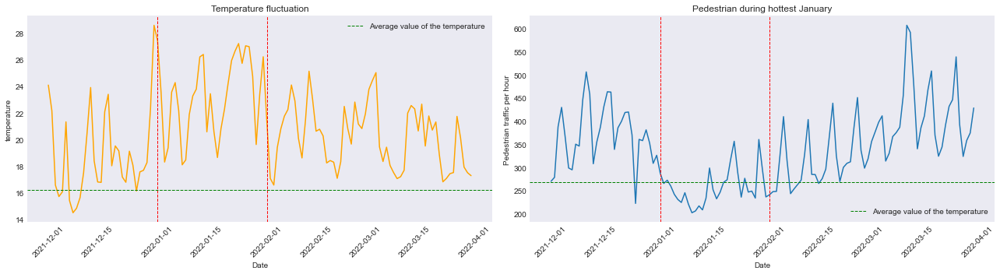

In [90]:
fig, ax = plt.subplots(1,2,figsize=(18,5))

# subplot for temperature
sns.lineplot(data=ped_daily_hot, x="Date", y="temperature", color="orange", ax=ax[0])
ax[0].axvline(x=pd.to_datetime("2022-01-01", format = '%Y-%m-%d'), color='r',  linestyle="--", linewidth=1)
ax[0].axvline(x=pd.to_datetime("2022-02-01", format = '%Y-%m-%d'), color='r', linestyle="--", linewidth=1)
ax[0].axhline(y=ped_daily["temperature"].mean(), color='green', label='Average value of the temperature', linestyle="--", linewidth=1)
ax[0].set_title("Temperature fluctuation")
ax[0].legend()
ax[0].tick_params(labelrotation=45, axis='x')

# subplot for pedestrian
sns.lineplot(data=ped_daily_hot, x="Date", y="hourly_counts", ax=ax[1])
ax[1].axvline(x=pd.to_datetime("2022-01-01", format = '%Y-%m-%d'), color='r', linestyle="--", linewidth=1)
ax[1].axvline(x=pd.to_datetime("2022-02-01", format = '%Y-%m-%d'), color='r', linestyle="--", linewidth=1)
ax[1].axhline(y=ped_daily["hourly_counts"].mean(), color='green', label='Average value of the temperature', linestyle="--", linewidth=1)
ax[1].set_title("Pedestrian during hottest January")
ax[1].set_ylabel('Pedestrian traffic per hour')
ax[1].legend()
ax[1].tick_params(labelrotation=45, axis='x')
fig.tight_layout()

**Hottest January since 1974**

According to the Bureau of Meteorology, Melbourne had the most days over 30 degrees on 17 days, tying the record set in 1974. It was also the first time since March 2013 that Melbourne had seven consecutive days over 30 degrees. We can see a significant drop in pedestrian volume during this January period. This phenomenon corroborates with the results of the previous correlation matrix.

##### Relation between microclimate and pedestrian traffic 

In [91]:
ped_daily['PM10']

0      27.861333
1      32.911667
2      28.391667
3      25.415833
4      28.940833
         ...    
862    28.389447
863    31.097895
864    25.668687
865    23.844330
866    29.130366
Name: PM10, Length: 867, dtype: float64

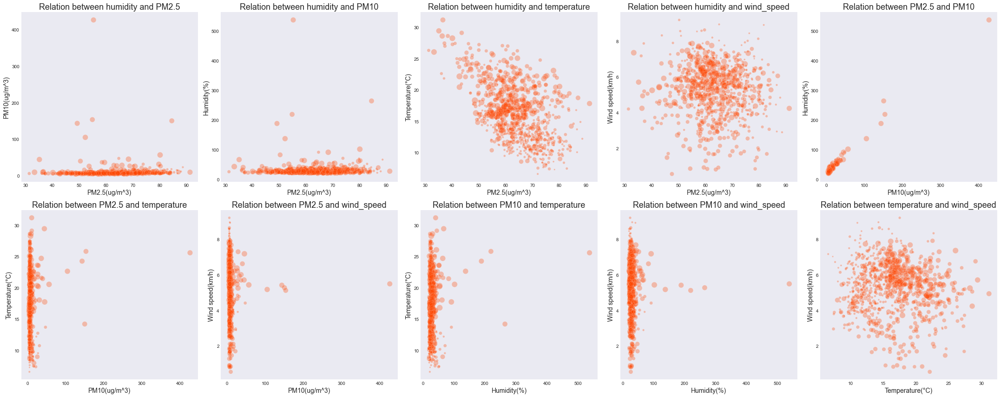

In [92]:
fig, ax = plt.subplots(2,5,figsize=(30,12))
cnt = 0
for i in range(5):
    for j in range(i+1, 5):
        subplot = ax[int(cnt/5)][cnt%5]
        sns.scatterplot(data=ped_daily, x=list(air_names.values())[i], y=list(air_names.values())[j],alpha=0.3,color="orangered", ax=subplot, s=ped_daily['hourly_counts']/4)
        # Set common labels
        subplot.set_xlabel(list(y_axis_labels.values())[i],fontsize = 14)
        subplot.set_ylabel(list(y_axis_labels.values())[j],fontsize = 14)
        cnt = cnt+1
        subplot.set_title('Relation between '+ list(air_names.values())[i] + " and " + list(air_names.values())[j], fontsize = 18)
        # ax2.set_title('ax2 title')
fig.tight_layout()

The figure above shows the relationship between each microclimate element and pedestrian volume. The horizontal and vertical coordinates indicate the microclimate elements respectively, while the scatter size indicates the pedestrian volume. We can find that the size distribution is rather scattered, with few more concentrated areas. There may be other factors that have more significant elements on the pedestrian volume, which we will explore further in Section 4.

##### Relation based on hours

In [93]:
df_microclimate.head()

,id,site_id,gateway_hub_id,sensor_id,value,local_time,type,units
0,1,1001,arc1045,0a.EPA-1h,3.9,2019-11-15T09:00:00.000,PM2.5-EPA-1h,ug/m^3
1,2,1001,arc1045,0a.EPA-1h.NOPK,3.9,2019-11-15T09:00:00.000,PM2.5-EPA-1h-NOPK,ug/m^3
2,3,1001,arc1045,0a.EPA-1h.NOPK.EPA-24h,5.5,2019-11-15T09:00:00.000,PM2.5-EPA-1h-NOPK-EPA-24h,ug/m^3
3,4,1001,arc1045,0a.EPA-1h.PKIND,1.0,2019-11-15T09:00:00.000,PM2.5-EPA-1h-PKIND,0/1
4,5,1001,arc1045,0a.EPA-24h,5.5,2019-11-15T09:00:00.000,PM2.5-EPA-24h,ug/m^3


In [94]:
ped_hour_mean = df_pedestrians_final.groupby([df_pedestrians_final["Date"].dt.to_period("H").rename("Date")]).agg({"hourly_counts":"mean"}).reset_index()

In [95]:
ped_hour = ped_hour_mean
# Merge all microclimate with PPM
for name in air_names.keys():
    ped_hour = ped_hour.merge(filter_data(name, "H"), left_on='Date', right_on='local_time',how="right")
    ped_hour = ped_hour.drop(columns=["local_time"])
    ped_hour = ped_hour.rename(columns={"value":air_names[name]})
ped_hour = ped_hour.dropna()

In [96]:
# change date to hour
ped_hour['Hour'] = ped_hour['Date'].astype(str)
ped_hour['Hour'] = pd.to_datetime(ped_hour['Hour']).dt.hour

In [97]:
# use count/100 for the size of circle in scatter plot
ped_hour['count/100'] = ped_hour['hourly_counts'] / 100

In [98]:
# This function is to create a subplot in bokeh
def draw_interactive_figure(df_, name): 
    y_axis_labels = {"PM2.5": "PM2.5(ug/m^3)",
                     "PM10": "PM10(ug/m^3)",
                     "humidity": "Humidity(%)",
                     "temperature": "Temperature(°C)",
                     "wind_speed": "Wind speed(km/h)"
                     
                    }
    p = figure(plot_width = 1000, plot_height = 500,title = "Relation", background_fill_color="#fafafa")
    p.xaxis.axis_label = 'Hours'
    p.yaxis.axis_label = y_axis_labels[name]

    p.scatter("Hour", name, source=df_, fill_alpha=0.05, size="count/100")
    p.title.text = "Relation " + name + " and Pedestrian"
    p.title.align = "center"
    p.title.text_font_size = "16px"

    tooltips = [
        (f"The amount of pedestrian: ", "@hourly_counts")]
    p.add_tools(HoverTool(tooltips=tooltips))
    return p

In [99]:
# create panels for figures in bokeh
panels = []
for name in air_names.values():
    panels.append(draw_interactive_figure(ped_hour, name))

In [100]:
# create tabs for figures in bokeh
tabs = []
for p, name in zip(panels, air_names.values()):
    tabs.append(Panel(child=p, title=name))

In [101]:
# show bokeh figue
show(Tabs(tabs=tabs))


In this section, we continue to zoom in on the time scale and explore the relationship between microenvironmental factors and pedestrian traffic in each hour. The figure is similar to Part 3.2 because it is obvious that the pedestrain has a strong relationship with the time. However, we cannot find a strong relationship between the microclimate, the number of pedestrians, and the time. We will dive into it in Part 3.4.

### 3.3.3. Combine Covid-19 and Microclimat

In [102]:
# Change "Day" columns to datetime in covid cases
long_au["Day"] = long_au["Day"].astype(str)
long_au["Day"] = pd.to_datetime(long_au["Day"])
# join covid with pedestrian
ped_daily_with_coivd = ped_daily.copy()
ped_daily_with_coivd["Date"] = ped_daily_with_coivd["Date"].astype(str)
ped_daily_with_coivd["Date"] = pd.to_datetime(ped_daily_with_coivd["Date"])
ped_daily_with_coivd = ped_daily_with_coivd.merge(long_au, left_on='Date', right_on='Day', how="left")
ped_daily_with_coivd = ped_daily_with_coivd.drop(columns=["Country/Region", "Day"])
ped_daily_with_coivd = ped_daily_with_coivd.fillna(0)

In [103]:
# Get new daily covid cases
case_1 = ped_daily_with_coivd["Cases"].shift(1)
ped_daily_with_coivd["new case"] = ped_daily_with_coivd["Cases"] - case_1
ped_daily_with_coivd = ped_daily_with_coivd.fillna(0)

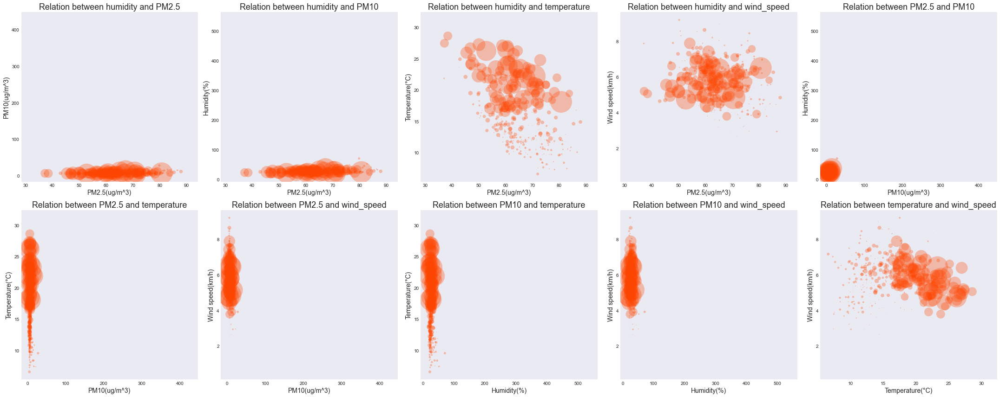

In [104]:
# Plot tht figure about the relation with each environmental factor and covid
fig, ax = plt.subplots(2,5,figsize=(30,12))
cnt = 0
for i in range(5):
    for j in range(i+1, 5):
        subplot = ax[int(cnt/5)][cnt%5]
        sns.scatterplot(data=ped_daily_with_coivd, x=list(air_names.values())[i], y=list(air_names.values())[j],alpha=0.3,color="orangered", ax=subplot, s=ped_daily_with_coivd["new case"]/20)
        # Set common labels
        subplot.set_xlabel(list(y_axis_labels.values())[i],fontsize = 14)
        subplot.set_ylabel(list(y_axis_labels.values())[j],fontsize = 14)
        cnt = cnt+1
        subplot.set_title('Relation between '+ list(air_names.values())[i] + " and " + list(air_names.values())[j], fontsize = 18)
        # ax2.set_title('ax2 title')
fig.tight_layout()

The figure above shows the relationship between each microclimate element and new active daily COVID cases. Compared with the similar figure in relation to microclimate and pedestrian traffic, this image shows a more concentrated trend. Especially in the image with the temperature and wind speed. However, we still cannot figure out the importance of each proposition of the pedestrian traffic. We will combine all of them to explain it more clearly. 

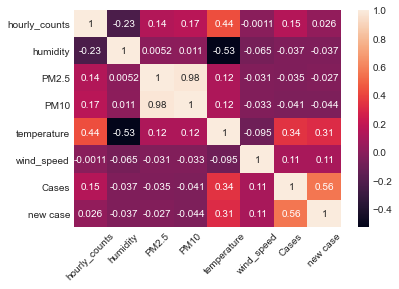

In [105]:
# corelation between climate and PPM
corr = ped_daily_with_coivd.drop(columns=["Date"]).corr()
sns.heatmap(corr, annot = True)
plt.tick_params(labelrotation=45, axis='x')

## 3.4. Machine Learning model

In this part, we will use a machine learning model, random forest, to explore the impact of COVID. Additionally, the model will be used on two datasets, with and without covid. Finally, we will compare two models and check their performance in predicting the pedestrian volumn.

### 3.4.1. Build model

#### Model without the covid-19 dateset

In [106]:
#First lets divide our data into our X matrix and y vector
X = ped_daily_with_coivd.copy()
y = ped_daily_with_coivd.hourly_counts.copy()
X = X.drop(columns=['hourly_counts','Date','new case'])
X_without_covid = X.drop(columns=['Cases'])

In [107]:
#Now, we're ready to split our dataset into training and test sets, 
#once again, random_state is specified, and test size is set to be 30%
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

In [108]:
# Number of trees in random forest
n_estimators = [100]+[int(x) for x in np.linspace(start = 200, stop = 2000, num = 10)]
# Number of features to consider at every split
max_features = ['auto', 'sqrt']
# Maximum number of levels in tree
max_depth = [5]+[int(x) for x in np.linspace(10, 100, num = 10)]
max_depth.append(None)
# Minimum number of samples required to split a node
min_samples_split = [2, 5, 10]
# Minimum number of samples required at each leaf node
min_samples_leaf = [1, 2, 4, 8]
# Method of selecting samples for training each tree
bootstrap = [True, False]
# Create the random grid
random_grid = {'n_estimators': n_estimators,
               'max_features': max_features,
               'max_depth': max_depth,
               'min_samples_split': min_samples_split,
               'min_samples_leaf': min_samples_leaf,
               'bootstrap': bootstrap}
print(random_grid)

{'n_estimators': [100, 200, 400, 600, 800, 1000, 1200, 1400, 1600, 1800, 2000], 'max_features': ['auto', 'sqrt'], 'max_depth': [5, 10, 20, 30, 40, 50, 60, 70, 80, 90, 100, None], 'min_samples_split': [2, 5, 10], 'min_samples_leaf': [1, 2, 4, 8], 'bootstrap': [True, False]}


In [109]:
forest_cv = RandomForestRegressor(random_state=42)

grid = RandomizedSearchCV(estimator = forest_cv, param_distributions=random_grid, cv = 5, verbose=2, n_jobs=-1, random_state=42)
grid.fit(X_train.drop(columns=['Cases']), y_train)

Fitting 5 folds for each of 10 candidates, totalling 50 fits


RandomizedSearchCV(cv=5, estimator=RandomForestRegressor(random_state=42),
                   n_jobs=-1,
                   param_distributions={'bootstrap': [True, False],
                                        'max_depth': [5, 10, 20, 30, 40, 50, 60,
                                                      70, 80, 90, 100, None],
                                        'max_features': ['auto', 'sqrt'],
                                        'min_samples_leaf': [1, 2, 4, 8],
                                        'min_samples_split': [2, 5, 10],
                                        'n_estimators': [100, 200, 400, 600,
                                                         800, 1000, 1200, 1400,
                                                         1600, 1800, 2000]},
                   random_state=42, verbose=2)

In [110]:
forest_without_covid = grid.best_estimator_
forest_without_covid.fit(X_train.drop(columns=["Cases"]), y_train)

RandomForestRegressor(max_depth=10, max_features='sqrt', min_samples_leaf=4,
                      n_estimators=800, random_state=42)

#### Model with covid-19 dateset

In [111]:
forest_cv = RandomForestRegressor(random_state=42)

grid = RandomizedSearchCV(estimator = forest_cv, param_distributions=random_grid, cv = 5, verbose=2, n_jobs=-1, random_state=42)
grid.fit(X_train, y_train)

Fitting 5 folds for each of 10 candidates, totalling 50 fits


RandomizedSearchCV(cv=5, estimator=RandomForestRegressor(random_state=42),
                   n_jobs=-1,
                   param_distributions={'bootstrap': [True, False],
                                        'max_depth': [5, 10, 20, 30, 40, 50, 60,
                                                      70, 80, 90, 100, None],
                                        'max_features': ['auto', 'sqrt'],
                                        'min_samples_leaf': [1, 2, 4, 8],
                                        'min_samples_split': [2, 5, 10],
                                        'n_estimators': [100, 200, 400, 600,
                                                         800, 1000, 1200, 1400,
                                                         1600, 1800, 2000]},
                   random_state=42, verbose=2)

In [112]:
forest_with_covid = grid.best_estimator_
forest_with_covid.fit(X_train, y_train)

RandomForestRegressor(max_depth=30, min_samples_leaf=4, n_estimators=400,
                      random_state=42)

### 3.4.2. Feature importnace

In [113]:
# This function is to create a subplot of feature importance
def draw_feature_importance(ax, forest):
    importances = forest.feature_importances_
    std = np.std([tree.feature_importances_ for tree in forest.estimators_], axis=0)

    importances = forest.feature_importances_
    append_text = ""
    if importances.size == X_without_covid.columns.size :
        X_col =  X_without_covid.columns
        append_text = "without covid cases"
    else :
        X_col = X.columns
        append_text = "with covid cases"

    forest_importances = pd.Series(importances, index=X_col)
    forest_std = pd.Series(std, index=X_col)


    top3 = forest_importances.nlargest(3).index
    ax.errorbar(y=X_col, x=forest_importances, xerr=forest_std, color='grey', fmt='o', alpha=0.9)
    ax.errorbar(y=top3, x=forest_importances[top3], xerr=forest_std[top3], fmt='bo')
    ax.set_title("Random Forest feature importances " + append_text, fontsize=14)
    ax.set_ylabel("Feature")
    ax.set_xlabel("Importance")
    return ax

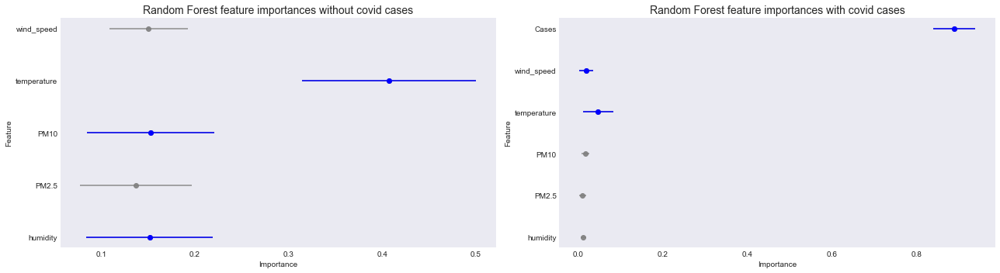

In [114]:
fig, ax = plt.subplots(1,2,figsize=(18,5))
ax[0] = draw_feature_importance(ax[0], forest_without_covid)
ax[1] = draw_feature_importance(ax[1], forest_with_covid)
fig.tight_layout()

The model set up the different feature importance in the dataset with and without COVID cases. In the model using COVID, it assigns the COVID feature over 0.8, which is more important than the sum of the rest of the features. While in the model without the COVID, the temp is occupied by the most significant part, about 0.35. The rest of the 4 features have the same importance of about 0.15. Based on these two quite different feater importance, we will check the performance to predict the pedestrian traffic in the following part.

### 3.4.3. Predictive model

In [115]:
y_pred_without_covid = forest_without_covid.predict(X_test.drop(columns=["Cases"]))
error_without_covid = mean_squared_error(y_test, y_pred_without_covid, squared=False)

y_pred_with_covid = forest_with_covid.predict(X_test)
error_with_covid = mean_squared_error(y_test, y_pred_with_covid, squared=False)

In [116]:
print("Model without covid: RMSE = {}".format(error_without_covid))
print("Model with covid: RMSE = {}".format(error_with_covid))

Model without covid: RMSE = 127.9892278631467
Model with covid: RMSE = 55.41807176375548


The performance of the two models is different. The model using COVID fits the pedestrian more accurately than another model. This result indirectly reflects the COVID impact on pedestrians. During the post-COVID period, pedestrian traffic is not only affected by the climate but also significantly changed by COVID. 

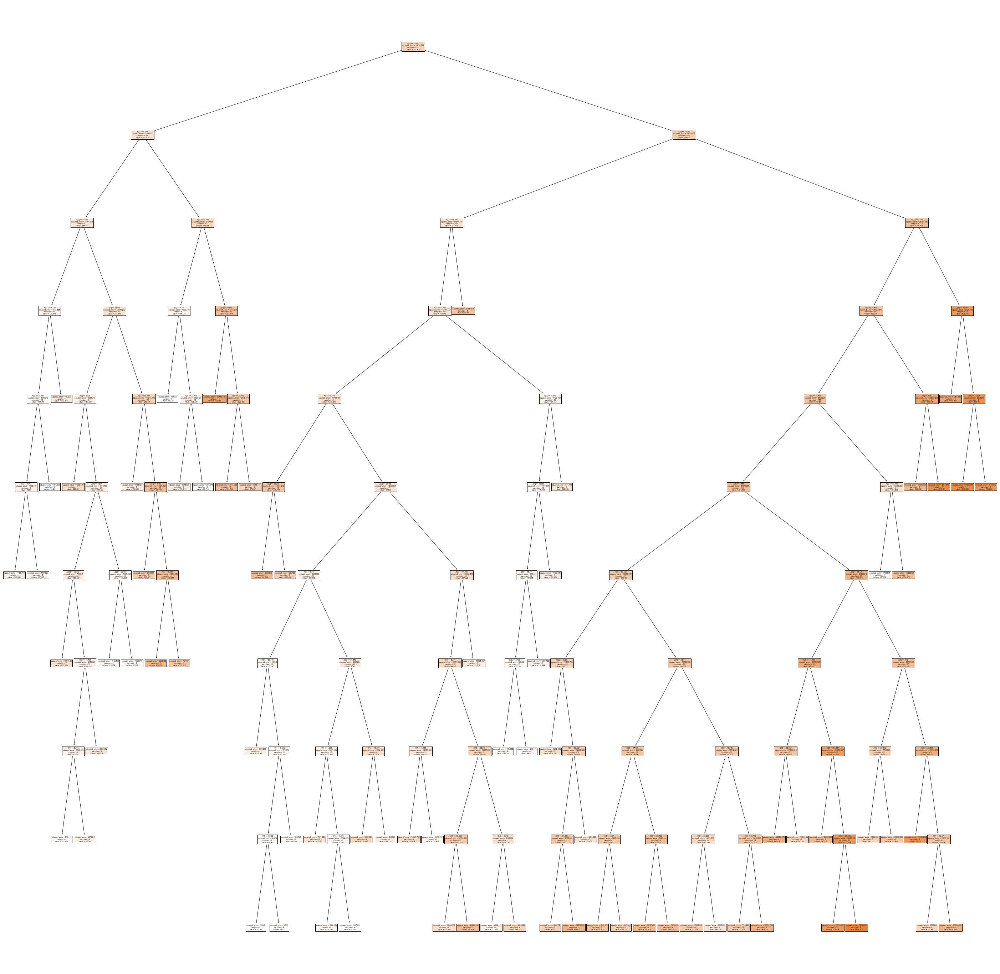

In [117]:
fig = plt.figure(figsize=(50,50))
_ = sklearn.tree.plot_tree(forest_without_covid.estimators_[0], filled=True)

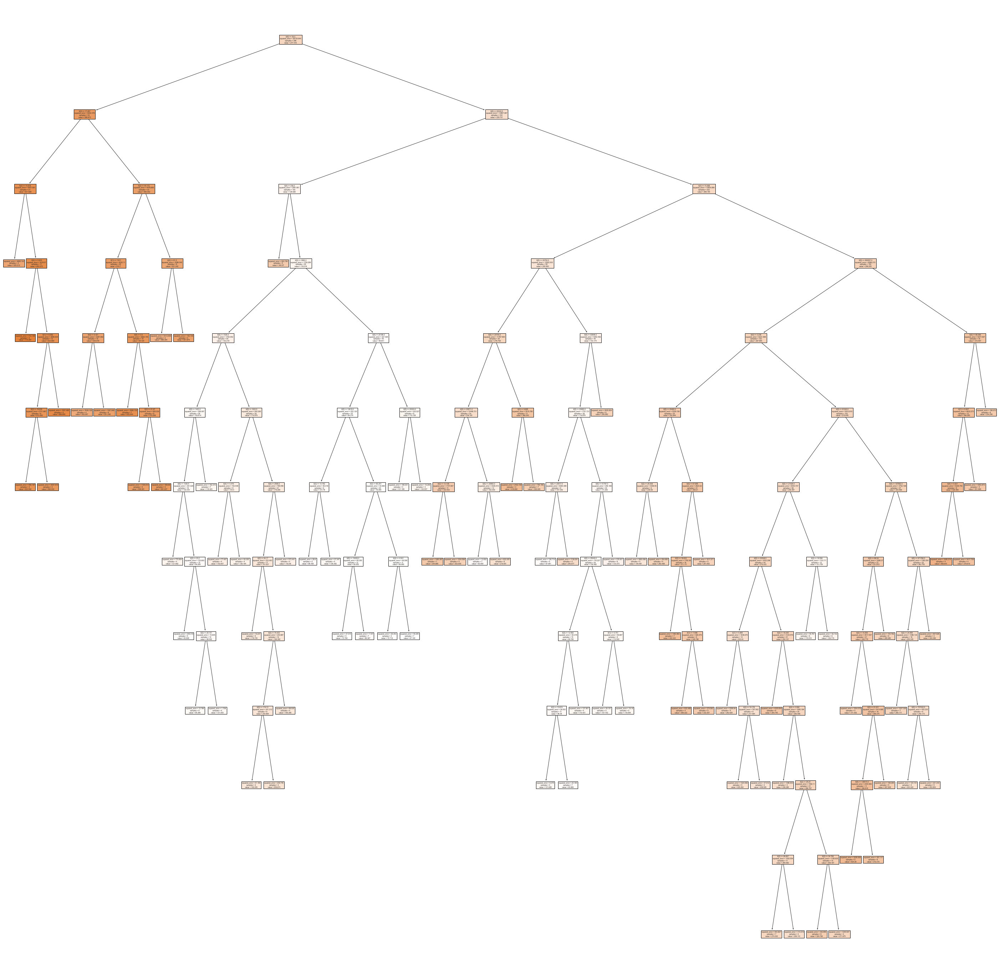

In [118]:
fig = plt.figure(figsize=(50,50))
_ = sklearn.tree.plot_tree(forest_with_covid.estimators_[0], filled=True)

# 4. Genre.
<a id='4'></a>

## 4.1. Which genre of data story did you use?


![Picture title](./image-20220505-150408.png)

The visualizations that we have chosen to show on our website after data analysis encompass few genres [14]. In general, we built our website in a wat that static visuals are close to **magazine style**, but some elements that place them close to partitioned poster. We've used **Annotated charts** and our *bokeh* plots may resemble of a **slide show** genre as the user can switch through the tabs. We've also prepared an *animation* to show temporal changes of pedestrians traffic.

To make our analysis as informative as possible, and to utilise the potential of the website as a medium, we combined elements of messaging with interactivity which ensures right balance between author-driven and reader-driven properties of our story. We didn't want our analysis to be purely descriptive, and interactivity allows us to engage the user into the story.

## 4.2. Which tools did you use from each of the 3 categories of Visual Narrative (Figure 7 in Segal and Heer). Why?



We've utilised several tools described by Segal and Heer. They've proved helpful in narrative data story setting to ensure clear and informative visuals.

- Visual Structuring
    - consistent visual platform - to minimise to cognitive load and ensure seamless experiece
    - progress bar / timebar - (in case of our animation) to inform the user what point in time is currently displayed
- Highlighting
    - zooming - to show the important part of the visualization
    - feature distinction - to direct the users focus and convey information
- Transition Guidance
    - continuinty editing - we tried to use this strategy to make the flow of the sotry smooth

## 4.3. Which tools did you use from each of the 3 categories of Narrative Structure (Figure 7 in Segal and Heer). Why?

We strived for the best possible Narrative Structure of our story. The tools that we utulised include:

- Ordering
    - linear - we designed our narrative data story in a way, that each next step reveals some more information and provides more insight into the topic; this could be best achieved with a linear order
- Interactivity 
    - hover highlighting - to provide more information to a curious user, and not to show to much information before hovering so that the visual is not cluttered
    - navigation buttons - to include more than one frame in a visual and let the user explore the data according to their needs
    - stimulating default view - to convey the most important message in an animation, and invite the user to play with it
- Messaging
    - captions / headlines - to give at glance information about the item
    - annotations - to provide clues what a visual is communicating
    - introducotry text - which allows the user to comprehend the visuals easily, instead of trying to figure out what are they looking at
    - summary / synthesis - we wanted the user to be able to explore, but at the same time we wanted to clearly communicate our findings

# 5. Visualizations.
<a id='5'></a>

## Our choice of visualizations you've chosen and why they are right for our story?

The ultimate goal of data visualization is to graphically represent information in a way that it provides us with insights that we couldn't draw from the raw data. In case of a narrative data story, we believe that it is important to find a balance in terms of the number of visuals and their complexity. That's why, for the purpose of the website, which was supposed to "aim at using visualization and explanation to get your data-driven insights across to a non-scientific reader" we had to limit the number of visuals. We decided to choose only the visualizations that were necessary for our story to be complete.

**Static charts**. Some of the charts that we used were static, which means that they were not interactive and their value was almost purely author-driven. In the case of the first plot for Covid-19 data and the barplot for pedestrians data, the aim was to show a brief and simple overview of the data, and we believe that magazine style / annotated charts with no interactivity were most suitable for this purpose. Then, in the case of our microclimate data analysis, we chose this type of visualization, because we wanted to convey a clear measage, so that the conclusion drawn from it is unambiguous.

**Bokeh interactive charts**. Visualizations in which we wanted to incorporate interactivity, were computed with Bokeh and exported as HTML for the purpose of our website. We used them as the next step of the narration, which allows to explore the topic further. Hovering is a great tool that ensures that a lot of information is reachable but not displayed at once, in order to keep the interface clear. This is also a great choice in our case, as it allows the user to choose how deeply do they want to dig into the topic. Once again we incorporated some highlighting techniques to poin the user's attention, at relevant parts.

**Interactive Animation**. To visualize the temporal dimension of the pedestrians data, we used the Kepler library and exported. the result as HTML. It allowed us to present the user with the default animation showing the temporal changes of pedestrian traffic pattern on a nice 3D map. At the same time, the interactivity of the map allows the user to further explore the data by playing with parameters. In this case, the 'default view' serves as a means of conveying the main message, but the user can also look for more patterns accorind to their needs.

# 6. Discussion. Think critically about your creation
<a id='6'></a>

## 6.1. Conclusions a.k.a. What went well?
Below you can find a comprehensive summary of the results we obtained from our data analysis and visual story:
- The visualizations are diverse, we used dynamic and static charts, even 3D maps. They show the relation clearly and understandably. 
- The analysis depended on different perspectives. We tried to explore each dataset separately, then combine them together, which made the whole exploration decent.
- Before starting the analysis, we analyzed the sensors in a very detailed way. It was learned which data were complete and which were mutilated and needed to be excluded. This step is critical because it is directly related to the quality of our dataset.

## 6.2. What is still missing? What could be improved? Why?

We've put much work, time and effort into this project and we are proud of the work we did. Nonetheless, we are aware that some things might be improved. We listed them below:

- We only have the pedestrian counting data in the Melbourne Central Business District (CBD), because the installed sensors are located there. 
- The pedestrian counts could be location-specific. Some of the sensors we not operating for the whole period of interest and so were dismissed (issue described and addressed in the preprocessing part).
- Working with real data may be challenging sometimes. Microclimat sensors data we worked with, started being recorded mid November 2019. Although it allowed us to have some idea about pre-covid reading, it would be better if we had the data for the whole year before covid as in the case of pedestrians data. It was not in our scope for this project, but if one wanted to explore this issue more, if could prove relevant to ssearch for additional data source.

# 7. Contributions. Who did what?
<a id='7'></a>


All three of us were highly motivated and engaged in the work. Throughout the project, we tried to divide the work in a fair way and were discussing each element of the analyses. We've held numerous meeting and online calls to be aligned with the current progress.

For the part A of the assignment we divided the work in the following way. Antek was responsible for the delivery of the video. Wojtek was performing the preliminary senson data analysis for the sake of the video. Weijun was researchnig and applying possible spacial data methods suitable for our problem.

For the part B, the main areas of responsibility were: 
- Covid-19 data preprocessing and visualization and website (Antek)
- Pedestrians traffic data preprocessig and visualizations (Wojtek)
- Microclimat data data preprocessig and visualizations (Weijun)

Though each area had its owner, we were still trying to help each other and discuss most of the steps of the analyses undertaken.

# 8. References 
<a id='8'></a>
- [1] Szczepanek R. (2020). Analysis of pedestrian activity before and during COVID-19 lockdown, using webcam time-lapse from Cracow and machine learning. PeerJ, 8, e10132. https://doi.org/10.7717/peerj.10132
- [2] https://journals.sagepub.com/doi/abs/10.3141/2140-04
- [3] https://www.sciencedirect.com/science/article/pii/S136192091300028X
- [4] https://github.com/CSSEGISandData/COVID-19
- [5] https://data.melbourne.vic.gov.au/Transport/Pedestrian-Counting-System-Sensor-Locations/h57g-5234
- [6] https://data.melbourne.vic.gov.au/Transport/Pedestrian-Counting-System-Monthly-counts-per-hour/b2ak-trbp
- [7] https://data.melbourne.vic.gov.au/Environment/Microclimate-Sensor-Locations/irqv-hjr4
- [8] https://data.melbourne.vic.gov.au/Environment/Microclimate-Sensor-Readings/u4vh-84j8
- [9] https://www.oecd.org/coronavirus/policy-responses/the-long-term-environmental-implications-of-covid-19-4b7a9937/
- [10] https://lockdownstats.melbourne/timeline/
- [11] https://www.abs.gov.au/statistics/people/population/national-state-and-territory-population/mar-2021
- [12] https://www.theage.com.au/national/victoria/city-sweltered-in-january-with-hot-nights-breaking-all-time-record-20220201-p59sxz.html
- [13] https://www.abs.gov.au/ausstats/abs@.nsf/Lookup/by%20Subject/1270.0.55.001~July%202016~Main%20Features~Statistical%20Area%20Level%202%20(SA2)~10014
- [14] E. Segel and J. Heer, "Narrative Visualization: Telling Stories with Data," in IEEE Transactions on Visualization and Computer Graphics, vol. 16, no. 6, pp. 1139-1148, Nov.-Dec. 2010, doi: 10.1109/TVCG.2010.179. http://vis.stanford.edu/files/2010-Narrative-InfoVis.pdf 

# 9. Appendix
<a id='9'></a>

## 9.1. Datasets' profiles

In [119]:
prof_covid = ProfileReport(cases)
prof_pedestrians = ProfileReport(df_pedestrian)
prof_microclimat = ProfileReport(df_microclimate)

### 9.1.1. Covid-19 data profile

In [120]:
# prof_covid.to_notebook_iframe()

### 9.1.2 Pedestrians traffis readings profile

In [121]:
# prof_pedestrians.to_notebook_iframe()

### 9.1.3. Microclimat data profile

In [122]:
# prof_microclimat.to_notebook_iframe()